# Self-Driving Car Engineer Nanodegree


## Camera Calibration 

I have setup a ipython notebook to work on the camera calibration


## Import Packages

In [1]:
import numpy as np
import cv2
import pickle
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

%matplotlib inline



## Output Images

Number of images =  20


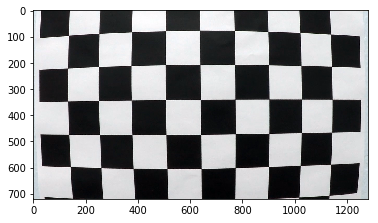

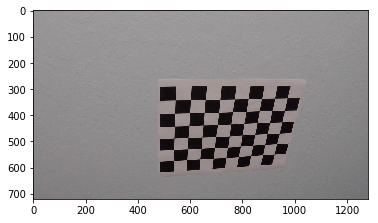

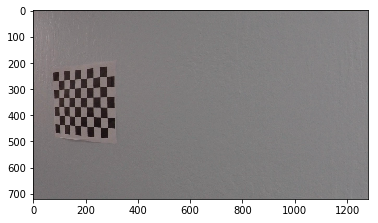

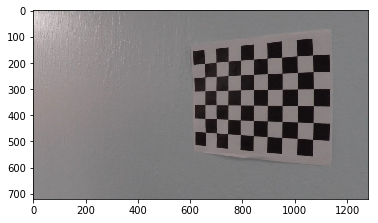

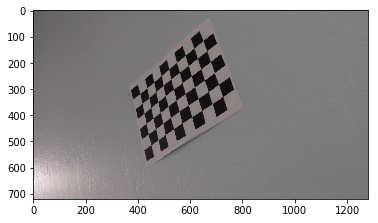

...

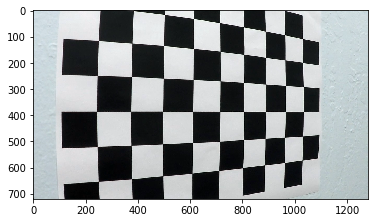

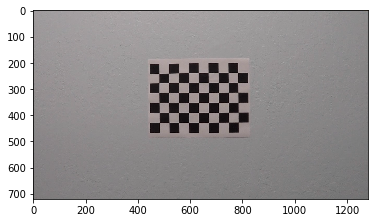

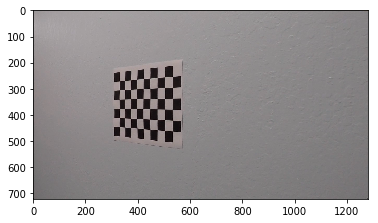

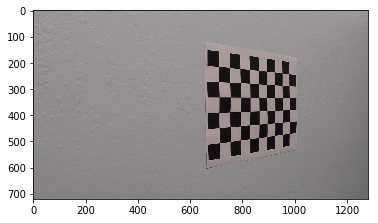

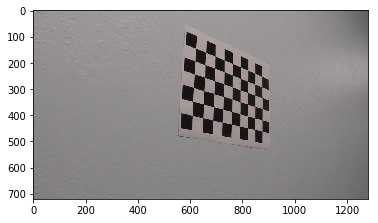

In [2]:
import os
#print(os.listdir("camera_cal/"))

images_to_load = [cv2.imread('camera_cal/' + i) for i in os.listdir('camera_cal/')]

print("Number of images = ", len(images_to_load))

for i in range(len(images_to_load)):
    img = images_to_load[i]
    
    plt.imshow(img)
    plt.show()


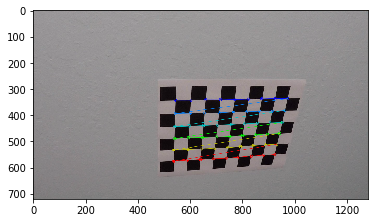

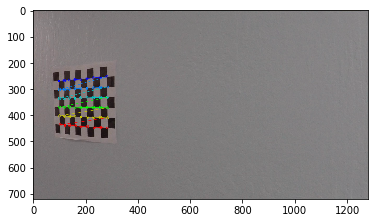

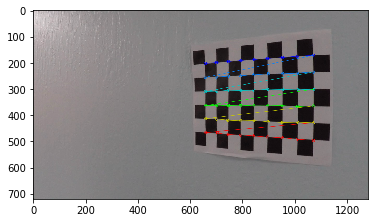

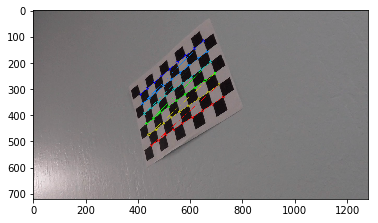

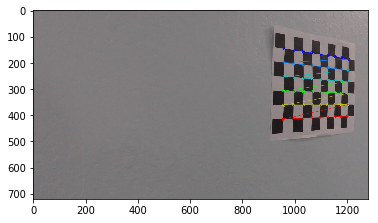

...

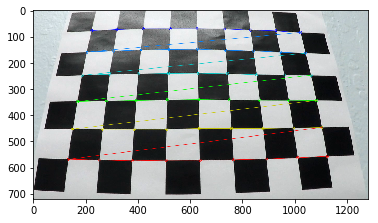

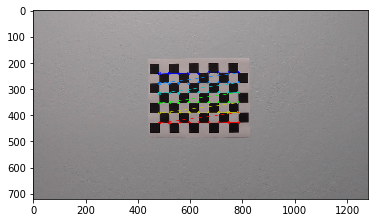

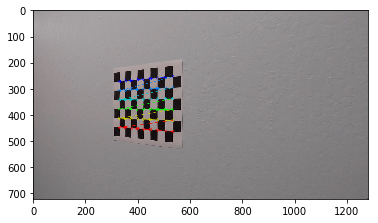

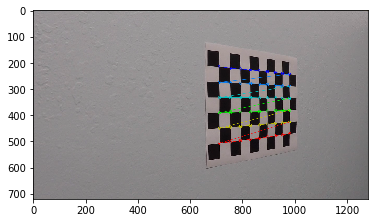

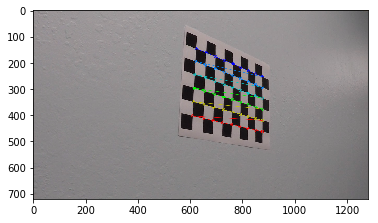

In [3]:
nx = 9
ny = 6
count = 0

# prepare object points
objpoints = [] #3D points in real world space
imgpoints = [] #2D points in image plane

objp = np.zeros((ny * nx, 3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1, 2) #x and y co-ordinates


for i in range(len(images_to_load)):
    img = images_to_load[i]
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, draw corners
    if ret == True:
        count =  count + 1
        imgpoints.append(corners)
        objpoints.append(objp)
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        plt.imshow(img)
        plt.show()

In [4]:
print("Number of images with chessboard corners = ", count)

Number of images with chessboard corners =  17


## Use Pickle to Save objpoints and imgpoints

In [5]:
points_pickle = {}
points_pickle["objpoints"] = objpoints
points_pickle["imgpoints"] = imgpoints

pickle.dump(points_pickle, open("camera_calibration_points.p", "wb" ) )

In [6]:
dist_pickle = pickle.load( open("camera_calibration_points.p", "rb" ) )
objpts = dist_pickle["objpoints"]
imgpts = dist_pickle["imgpoints"]

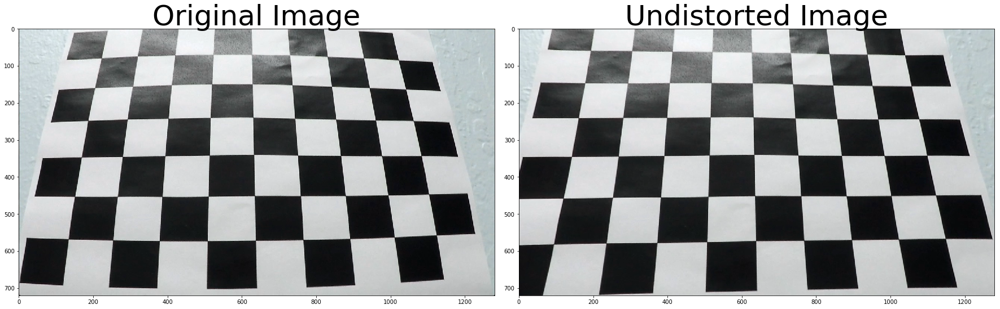

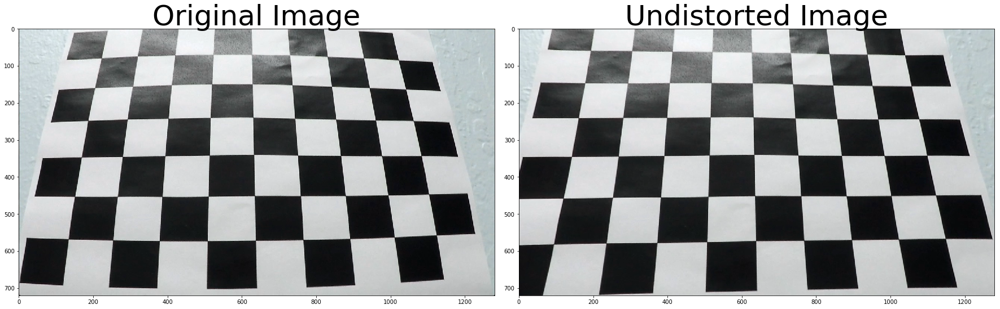

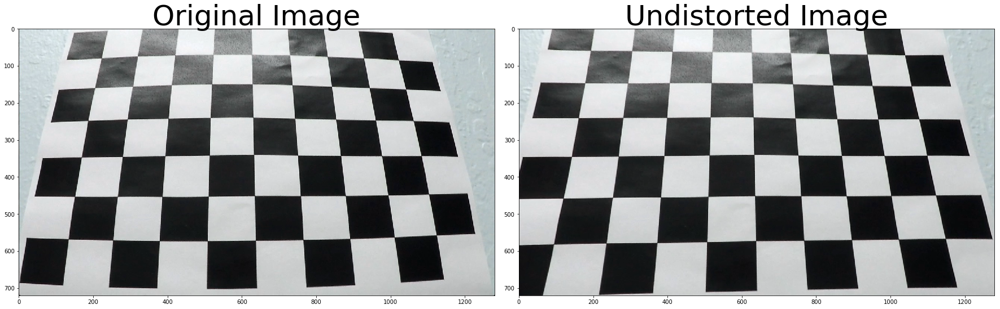

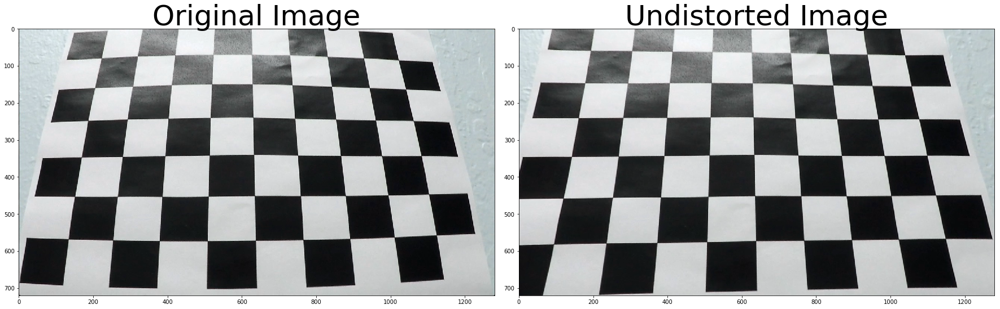

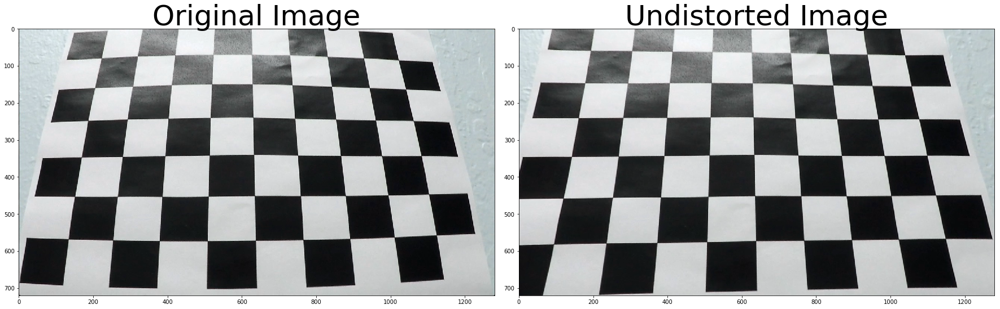

...

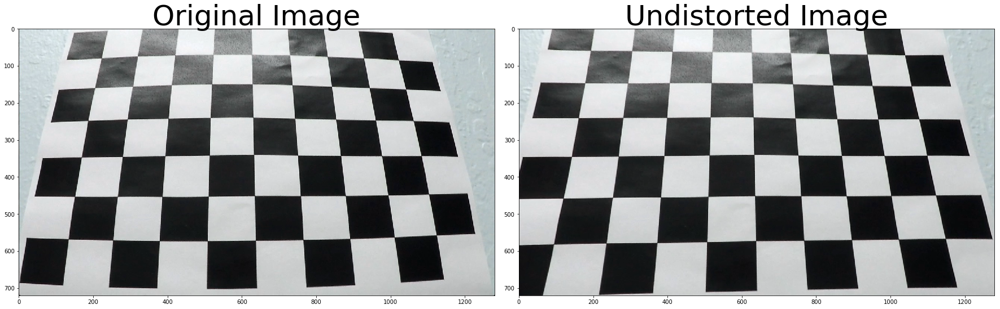

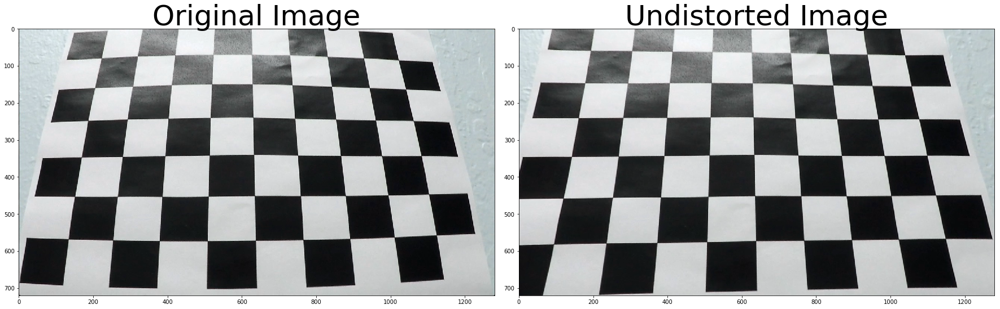

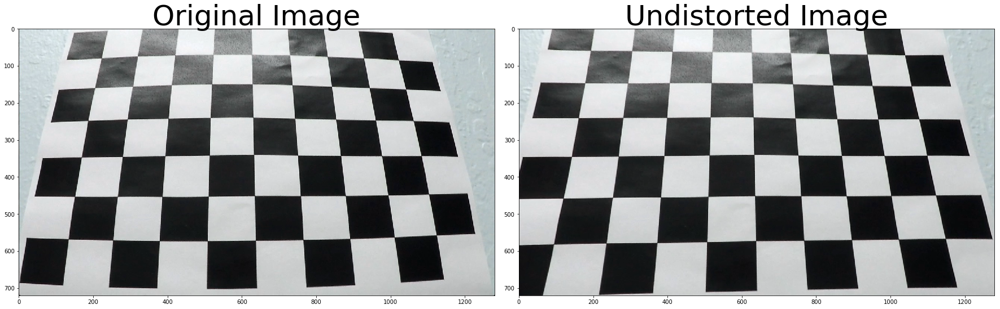

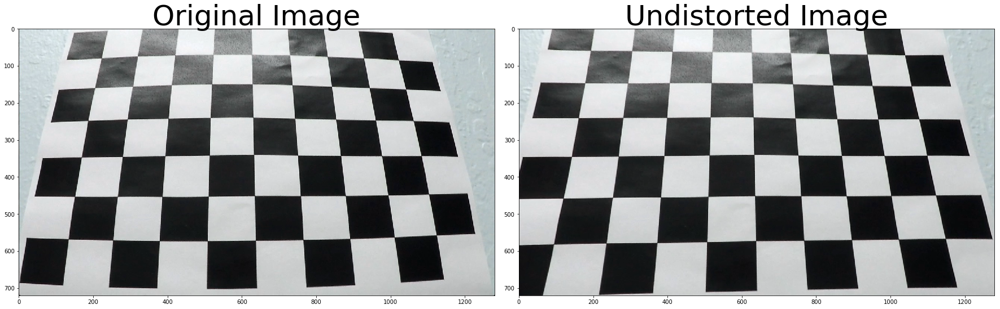

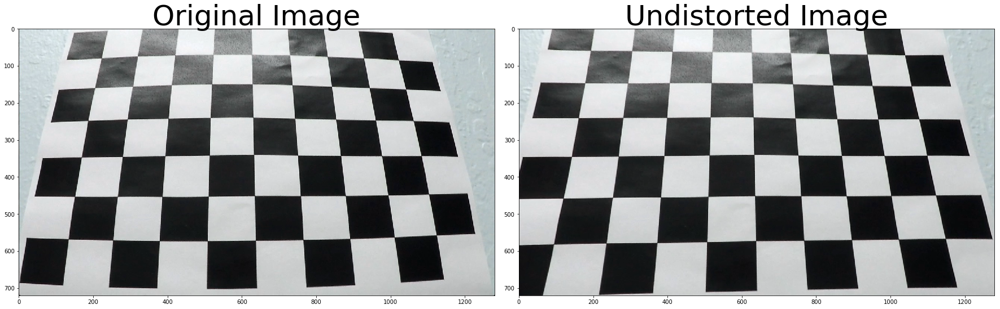

In [33]:
image_to_test = cv2.imread('camera_cal/calibration3.jpg')

def cal_undistort(image, obj_points, img_points):
    # Use cv2.calibrateCamera() and cv2.undistort()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, image.shape[1::-1], None, None)
    dst = cv2.undistort(image, mtx, dist, None, mtx)
    return dst

for i in range(len(images_to_load)):
    img_to_test = images_to_load[i]
    undistorted = cal_undistort(image_to_test, objpts, imgpts)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image_to_test)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

Text(0.5,1,'Undistorted Image')

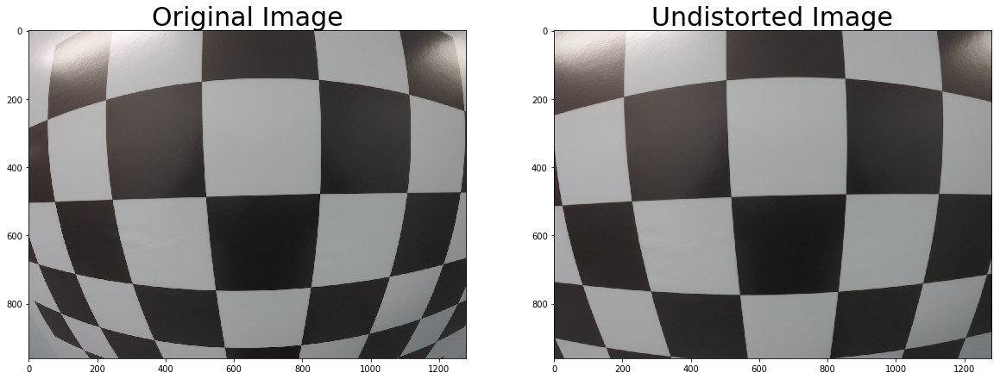

In [34]:
# Test undistortion on an image
test_img = cv2.imread('calibration_wide/test_image.jpg')
test_img_size = (test_img.shape[1], test_img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpts, imgpts, test_img_size,None,None)


dst = cv2.undistort(test_img, mtx, dist, None, mtx)
cv2.imwrite('calibration_wide/test_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "calibration_wide/wide_dist_pickle.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(test_img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

In [36]:
print(mtx)

[[  1.15777818e+03   0.00000000e+00   6.67113857e+02]
 [  0.00000000e+00   1.15282217e+03   3.86124583e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]


In [37]:
print(dist)

[[-0.24688507 -0.02373156 -0.00109831  0.00035107 -0.00259865]]
